In [1]:
import numpy as np
import cv2
import os
import torch
from ultralytics import YOLO
import joblib
import matplotlib.pyplot as plt

from sklearn.ensemble import RandomForestClassifier

C:\tools\Manim\Lib\site-packages\scipy\__init__.py:169: UserWarning: A NumPy version >=1.18.5 and <1.26.0 is required for this version of SciPy (detected version 1.26.4
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
ROOT_DIR = "D:/TrafficLightTrainingDataset/"
ranEpochs = 300

In [3]:
model = YOLO(os.path.join(ROOT_DIR, f"results/trainM{ranEpochs}epochs/weights/best.pt"))
print(model)

YOLO(
  (model): DetectionModel(
    (model): Sequential(
      (0): Conv(
        (conv): Conv2d(3, 48, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (bn): BatchNorm2d(48, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
        (act): SiLU(inplace=True)
      )
      (1): Conv(
        (conv): Conv2d(48, 96, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (bn): BatchNorm2d(96, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
        (act): SiLU(inplace=True)
      )
      (2): C2f(
        (cv1): Conv(
          (conv): Conv2d(96, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn): BatchNorm2d(96, eps=0.001, momentum=0.03, affine=True, track_running_stats=True)
          (act): SiLU(inplace=True)
        )
        (cv2): Conv(
          (conv): Conv2d(192, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn): BatchNorm2d(96, eps=0.001, momentum=0.03, affine=True, track_running_

In [29]:
import glob
images = [cv2.imread(file) for file in glob.glob(os.path.join(ROOT_DIR, "images/*.png"))[::50]]
rgbs = [cv2.cvtColor(img, cv2.COLOR_BGR2RGB) for img in images]

print(images.__len__())

102


In [30]:
model_RF = joblib.load(os.path.join(ROOT_DIR, "model.joblib"))

In [31]:
class_labels = ["Green", "Red", "Yellow", "Off"]

In [32]:
results = model(images)


0: 416x736 1 trafficLight, 1: 416x736 4 trafficLights, 2: 416x736 (no detections), 3: 416x736 2 trafficLights, 4: 416x736 3 trafficLights, 5: 416x736 (no detections), 6: 416x736 (no detections), 7: 416x736 3 trafficLights, 8: 416x736 6 trafficLights, 9: 416x736 (no detections), 10: 416x736 4 trafficLights, 11: 416x736 (no detections), 12: 416x736 1 trafficLight, 13: 416x736 (no detections), 14: 416x736 5 trafficLights, 15: 416x736 (no detections), 16: 416x736 (no detections), 17: 416x736 1 trafficLight, 18: 416x736 (no detections), 19: 416x736 (no detections), 20: 416x736 4 trafficLights, 21: 416x736 6 trafficLights, 22: 416x736 (no detections), 23: 416x736 4 trafficLights, 24: 416x736 (no detections), 25: 416x736 (no detections), 26: 416x736 2 trafficLights, 27: 416x736 (no detections), 28: 416x736 (no detections), 29: 416x736 (no detections), 30: 416x736 (no detections), 31: 416x736 3 trafficLights, 32: 416x736 3 trafficLights, 33: 416x736 (no detections), 34: 416x736 (no detections

In [ ]:
i = 0
for result in results:
    #print("------------------------------")
    #result.show()
    for box in result.boxes.cpu().numpy():
        box = np.int_(box.xyxy.tolist()[0])
        cropped = rgbs[i][box[1]:box[3], box[0]:box[2]]
        classVal = model_RF.predict([cv2.resize(cropped, (100, 100)).flatten()])
        plt.subplots(1)
        plt.title(class_labels[classVal[0]])
        plt.imshow(cropped)
    i += 1

C:\Users\USER\AppData\Local\Temp\ipykernel_19664\2933605426.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.subplots(1)


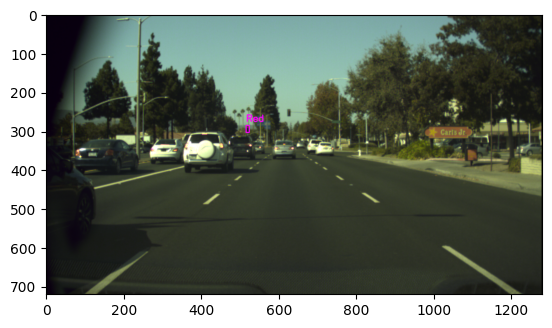

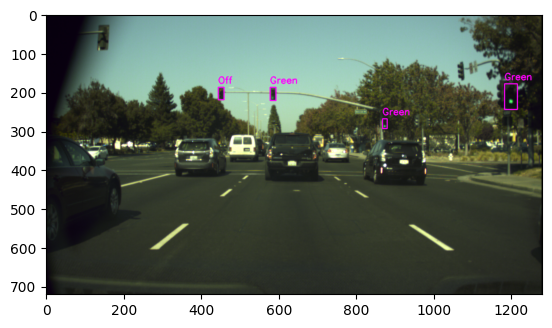

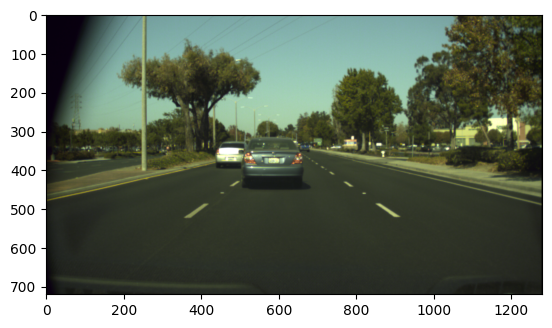

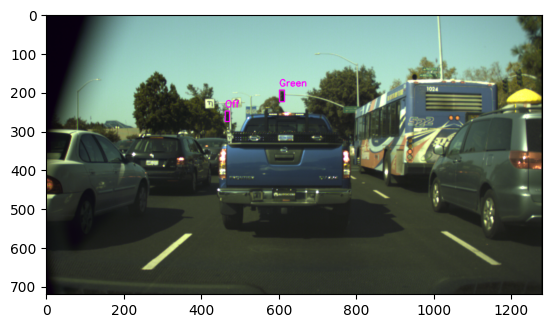

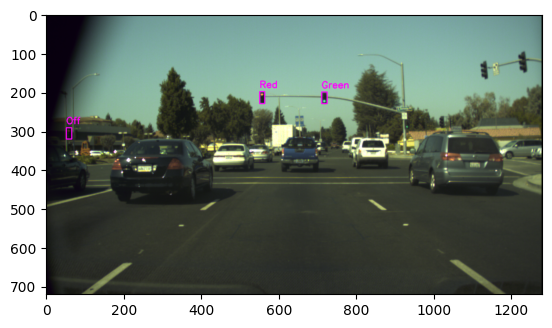

...

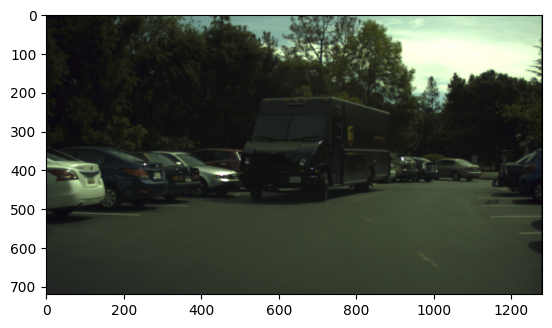

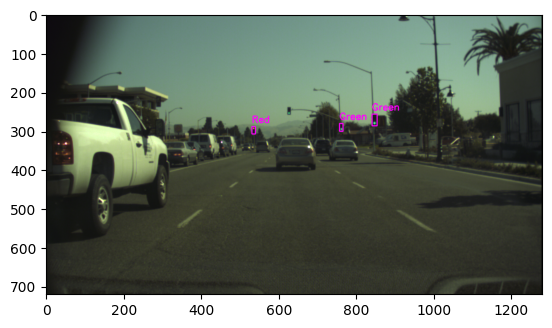

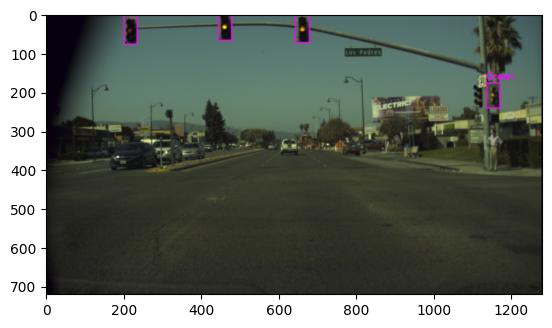

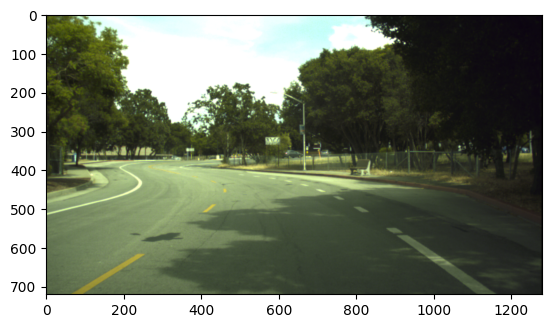

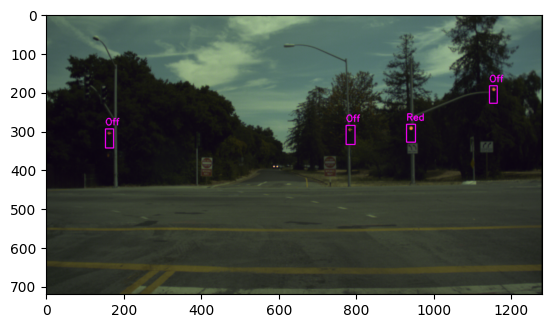

In [37]:
i = 0
for result in results:
    img_result = rgbs[i]

    for box in result.boxes.cpu().numpy():
        box = np.int_(box.xyxy.tolist()[0])
        img_result = cv2.rectangle(img_result, (box[0], box[1]), (box[2], box[3]), (255, 0, 255), 2)

        cropped = img_result[box[1]:box[3], box[0]:box[2]]
        classVal = model_RF.predict([cv2.resize(cropped, (100, 100)).flatten()])
        cv2.putText(img_result, class_labels[classVal[0]], (box[0], box[1] - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (255, 0, 255), 2)

    plt.subplots(1)
    plt.imshow(img_result)
    img_result = cv2.cvtColor(img_result, cv2.COLOR_RGB2BGR)
    cv2.imwrite(os.path.join(ROOT_DIR, "final results/" + str(i) + ".png"), img_result)
    i += 1